In [1]:
import os
import glob
import time
import numpy as np
from PIL import Image
from pathlib import Path
from tqdm.notebook import tqdm
import matplotlib.pyplot as plt
from skimage.color import rgb2lab, lab2rgb

import torch
from torch import nn, optim
from torchvision import transforms
from torchvision.utils import make_grid
from torch.utils.data import Dataset, DataLoader
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
use_colab = None

In [2]:
!pip install fastai==2.4

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 187.9/187.9 kB 392.3 kB/s eta 0:00:00a 0:00:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 831.4/831.4 MB 1.2 MB/s eta 0:00:0000:0100:02
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.0/56.0 kB 5.2 MB/s eta 0:00:00
  Attempting uninstall: torch
    Found existing installation: torch 1.11.0
    Uninstalling torch-1.11.0:
      Successfully uninstalled torch-1.11.0
  Attempting uninstall: fastcore
    Found existing installation: fastcore 1.5.27
    Uninstalling fastcore-1.5.27:
      Successfully uninstalled fastcore-1.5.27
  Attempting uninstall: fastai
    Found existing installation: fastai 2.7.9
    Uninstalling fastai-2.7.9:
      Successfully uninstalled fastai-2.7.9
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
allennlp 2.10.1 requires torch<1.13.0,>=1.10.0, but you have torch 1.9.1 which is incompatible.


In [3]:
from fastai.data.external import untar_data, URLs
coco_path = untar_data(URLs.COCO_SAMPLE)
coco_path = str(coco_path) + "/train_sample"
use_colab = True

In [4]:
if use_colab == True:
    path = coco_path
else:
    path = "Your path to the dataset"
    
paths = glob.glob(path + "/*.jpg") # Grabbing all the image file names
np.random.seed(123)
paths_subset = np.random.choice(paths, 10_000, replace=False) # choosing 10000 images randomly
rand_idxs = np.random.permutation(10_000)
train_idxs = rand_idxs[:8000] # choosing the first 8000 as training set
val_idxs = rand_idxs[8000:] # choosing last 2000 as validation set
train_paths = paths_subset[train_idxs]
val_paths = paths_subset[val_idxs]
print(len(train_paths), len(val_paths))

8000 2000


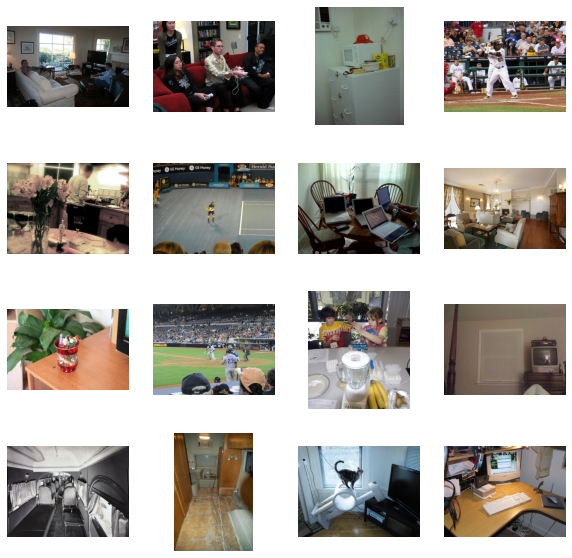

In [5]:
_, axes = plt.subplots(4, 4, figsize=(10, 10))
for ax, img_path in zip(axes.flatten(), train_paths):
    ax.imshow(Image.open(img_path))
    ax.axis("off")

In [6]:
SIZE = 256
class ColorizationDataset(Dataset):
    def __init__(self, paths, split='train'):
        if split == 'train':
            self.transforms = transforms.Compose([
                transforms.Resize((SIZE, SIZE),  Image.BICUBIC),
#                 transforms.RandomHorizontalFlip()
            ])
        elif split == 'val':
            self.transforms = transforms.Resize((SIZE, SIZE),  Image.BICUBIC)
        
        self.split = split
        self.size = SIZE
        self.paths = paths
    
    def __getitem__(self, idx):
        img = Image.open(self.paths[idx]).convert("RGB")
        img = self.transforms(img)
        img = np.array(img)
        img_lab = rgb2lab(img).astype("float32") 
        img_lab = transforms.ToTensor()(img_lab)
        L = img_lab[[0], ...] / 50. - 1. 
        ab = img_lab[[1, 2], ...] / 110.
        
        return {'L': L, 'ab': ab}
    
    def __len__(self):
        return len(self.paths)

def make_dataloaders(batch_size=16, n_workers=4, pin_memory=True, **kwargs): 
    dataset = ColorizationDataset(**kwargs)
    dataloader = DataLoader(dataset, batch_size=batch_size, num_workers=n_workers,pin_memory=pin_memory)
    return dataloader

In [7]:
train_dl = make_dataloaders(paths=train_paths, split='train')
val_dl = make_dataloaders(paths=val_paths, split='val')

data = next(iter(train_dl))
Ls, abs_ = data['L'], data['ab']
print(Ls.shape, abs_.shape)
print(len(train_dl), len(val_dl))

/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:6: DeprecationWarning: BICUBIC is deprecated and will be removed in Pillow 10 (2023-07-01). Use Resampling.BICUBIC instead.
  
/opt/conda/lib/python3.7/site-packages/torchvision/transforms/transforms.py:333: UserWarning: Argument interpolation should be of type InterpolationMode instead of int. Please, use InterpolationMode enum.
  "Argument interpolation should be of type InterpolationMode instead of int. "
/opt/conda/lib/python3.7/site-packages/torch/utils/data/dataloader.py:490: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  self._drop_last = loader.drop_last
/opt/conda/lib/python3.7/site-packages/ipykernel_laun

torch.Size([16, 1, 256, 256]) torch.Size([16, 2, 256, 256])
500 125


In [8]:
class UnetBlock(nn.Module):
    def __init__(self, nf, ni, submodule=None, input_c=None, dropout=False,
                 innermost=False, outermost=False):
        super().__init__()
        self.outermost = outermost
        if input_c is None: input_c = nf
        downconv = nn.Conv2d(input_c, ni, kernel_size=4,
                             stride=2, padding=1, bias=False)
        downrelu = nn.LeakyReLU(0.2, True)
        downnorm = nn.BatchNorm2d(ni)
        uprelu = nn.ReLU(True)
        upnorm = nn.BatchNorm2d(nf)
        
        if outermost:
            upconv = nn.ConvTranspose2d(ni * 2, nf, kernel_size=4,
                                        stride=2, padding=1)
            down = [downconv]
            up = [uprelu, upconv, nn.Tanh()]
            model = down + [submodule] + up
        elif innermost:
            upconv = nn.ConvTranspose2d(ni, nf, kernel_size=4,
                                        stride=2, padding=1, bias=False)
            down = [downrelu, downconv]
            up = [uprelu, upconv, upnorm]
            model = down + up
        else:
            upconv = nn.ConvTranspose2d(ni * 2, nf, kernel_size=4,
                                        stride=2, padding=1, bias=False)
            down = [downrelu, downconv, downnorm]
            up = [uprelu, upconv, upnorm]
            if dropout: up += [nn.Dropout(0.5)]
            model = down + [submodule] + up
        self.model = nn.Sequential(*model)
    
    def forward(self, x):
        if self.outermost:
            return self.model(x)
        else:
            return torch.cat([x, self.model(x)], 1)

class Unet(nn.Module):
    def __init__(self, input_c=1, output_c=2, n_down=8, num_filters=64):
        super().__init__()
        unet_block = UnetBlock(num_filters * 8, num_filters * 8, innermost=True)
        for _ in range(n_down - 5):
            unet_block = UnetBlock(num_filters * 8, num_filters * 8, submodule=unet_block, dropout=True)
        out_filters = num_filters * 8
        for _ in range(3):
            unet_block = UnetBlock(out_filters // 2, out_filters, submodule=unet_block)
            out_filters //= 2
        self.model = UnetBlock(output_c, out_filters, input_c=input_c, submodule=unet_block, outermost=True)
    
    def forward(self, x):
        return self.model(x)

In [9]:
class PatchDiscriminator(nn.Module):
    def __init__(self, input_c, num_filters=64, n_down=3):
        super().__init__()
        model = [self.get_layers(input_c, num_filters, norm=False)]
        model += [self.get_layers(num_filters * 2 ** i, num_filters * 2 ** (i + 1), s=1 if i == (n_down-1) else 2) 
                          for i in range(n_down)] # the 'if' statement is taking care of not using stride of 2 for the last block in this loop
        model += [self.get_layers(num_filters * 2 ** n_down, 1, s=1, norm=False, act=False)] # Do not use normalization or activation for the last layer of the model
        self.model = nn.Sequential(*model)                                                   
        
    def get_layers(self, ni, nf, k=4, s=2, p=1, norm=True, act=True): # to make some repeatitive blocks of layers,
        layers = [nn.Conv2d(ni, nf, k, s, p, bias=not norm)]         
        if norm: layers += [nn.BatchNorm2d(nf)]
        if act: layers += [nn.LeakyReLU(0.2, True)]
        return nn.Sequential(*layers)
    
    def forward(self, x):
        return self.model(x)

In [10]:
PatchDiscriminator(3)

PatchDiscriminator(
  (model): Sequential(
    (0): Sequential(
      (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
      (1): LeakyReLU(negative_slope=0.2, inplace=True)
    )
    (1): Sequential(
      (0): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): LeakyReLU(negative_slope=0.2, inplace=True)
    )
    (2): Sequential(
      (0): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (1): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): LeakyReLU(negative_slope=0.2, inplace=True)
    )
    (3): Sequential(
      (0): Conv2d(256, 512, kernel_size=(4, 4), stride=(1, 1), padding=(1, 1), bias=False)
      (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): LeakyReLU(negative_slope=0.2, inplace=True)
    )
    (

In [11]:
discriminator = PatchDiscriminator(3)
dummy_input = torch.randn(16, 3, 256, 256) # batch_size, channels, size, size
out = discriminator(dummy_input)
out.shape

torch.Size([16, 1, 30, 30])

In [12]:
class GANLoss(nn.Module):
    def __init__(self, gan_mode='vanilla', real_label=1.0, fake_label=0.0):
        super().__init__()
        self.register_buffer('real_label', torch.tensor(real_label))
        self.register_buffer('fake_label', torch.tensor(fake_label))
        if gan_mode == 'vanilla':
            self.loss = nn.BCEWithLogitsLoss()
        elif gan_mode == 'lsgan':
            self.loss = nn.MSELoss()
    
    def get_labels(self, preds, target_is_real):
        if target_is_real:
            labels = self.real_label
        else:
            labels = self.fake_label
        return labels.expand_as(preds)
    
    def __call__(self, preds, target_is_real):
        labels = self.get_labels(preds, target_is_real)
        loss = self.loss(preds, labels)
        return loss

In [13]:
def init_weights(net, init='norm', gain=0.02):
    
    def init_func(m):
        classname = m.__class__.__name__
        if hasattr(m, 'weight') and 'Conv' in classname:
            if init == 'norm':
                nn.init.normal_(m.weight.data, mean=0.0, std=gain)
            elif init == 'xavier':
                nn.init.xavier_normal_(m.weight.data, gain=gain)
            elif init == 'kaiming':
                nn.init.kaiming_normal_(m.weight.data, a=0, mode='fan_in')
            
            if hasattr(m, 'bias') and m.bias is not None:
                nn.init.constant_(m.bias.data, 0.0)
        elif 'BatchNorm2d' in classname:
            nn.init.normal_(m.weight.data, 1., gain)
            nn.init.constant_(m.bias.data, 0.)
            
    net.apply(init_func)
    print(f"model initialized with {init} initialization")
    return net

def init_model(model, device):
    model = model.to(device)
    model = init_weights(model)
    return model

In [14]:
class MainModel(nn.Module):
    def __init__(self, net_G=None, lr_G=2e-4, lr_D=2e-4, 
                 beta1=0.5, beta2=0.999, lambda_L1=100.):
        super().__init__()
        
        self.device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
        self.lambda_L1 = lambda_L1
        
        if net_G is None:
            self.net_G = init_model(Unet(input_c=1, output_c=2, n_down=8, num_filters=64), self.device)
        else:
            self.net_G = net_G.to(self.device)
        self.net_D = init_model(PatchDiscriminator(input_c=3, n_down=3, num_filters=64), self.device)
        self.GANcriterion = GANLoss(gan_mode='vanilla').to(self.device)
        self.L1criterion = nn.L1Loss()
        self.opt_G = optim.Adam(self.net_G.parameters(), lr=lr_G, betas=(beta1, beta2))
        self.opt_D = optim.Adam(self.net_D.parameters(), lr=lr_D, betas=(beta1, beta2))
    
    def set_requires_grad(self, model, requires_grad=True):
        for p in model.parameters():
            p.requires_grad = requires_grad
        
    def setup_input(self, data):
        self.L = data['L'].to(self.device)
        self.ab = data['ab'].to(self.device)
        
    def forward(self):
        self.fake_color = self.net_G(self.L)
    
    def backward_D(self):
        fake_image = torch.cat([self.L, self.fake_color], dim=1)
        fake_preds = self.net_D(fake_image.detach())
        self.loss_D_fake = self.GANcriterion(fake_preds, False)
        real_image = torch.cat([self.L, self.ab], dim=1)
        real_preds = self.net_D(real_image)
        self.loss_D_real = self.GANcriterion(real_preds, True)
        self.loss_D = (self.loss_D_fake + self.loss_D_real) * 0.5
        self.loss_D.backward()
    
    def backward_G(self):
        fake_image = torch.cat([self.L, self.fake_color], dim=1)
        fake_preds = self.net_D(fake_image)
        self.loss_G_GAN = self.GANcriterion(fake_preds, True)
        self.loss_G_L1 = self.L1criterion(self.fake_color, self.ab) * self.lambda_L1
        self.loss_G = self.loss_G_GAN + self.loss_G_L1
        self.loss_G.backward()
    
    def optimize(self):
        self.forward()
        self.net_D.train()
        self.set_requires_grad(self.net_D, True)
        self.opt_D.zero_grad()
        self.backward_D()
        self.opt_D.step()
        
        self.net_G.train()
        self.set_requires_grad(self.net_D, False)
        self.opt_G.zero_grad()
        self.backward_G()
        self.opt_G.step()

In [15]:
class AverageMeter:
    def __init__(self):
        self.reset()
        
    def reset(self):
        self.count, self.avg, self.sum = [0.] * 3
    
    def update(self, val, count=1):
        self.count += count
        self.sum += count * val
        self.avg = self.sum / self.count

def create_loss_meters():
    loss_D_fake = AverageMeter()
    loss_D_real = AverageMeter()
    loss_D = AverageMeter()
    loss_G_GAN = AverageMeter()
    loss_G_L1 = AverageMeter()
    loss_G = AverageMeter()
    
    return {'loss_D_fake': loss_D_fake,
            'loss_D_real': loss_D_real,
            'loss_D': loss_D,
            'loss_G_GAN': loss_G_GAN,
            'loss_G_L1': loss_G_L1,
            'loss_G': loss_G}

def update_losses(model, loss_meter_dict, count):
    for loss_name, loss_meter in loss_meter_dict.items():
        loss = getattr(model, loss_name)
        loss_meter.update(loss.item(), count=count)

def lab_to_rgb(L, ab):
    """
    Takes a batch of images
    """
    
    L = (L + 1.) * 50.
    ab = ab * 110.
    Lab = torch.cat([L, ab], dim=1).permute(0, 2, 3, 1).cpu().numpy()
    rgb_imgs = []
    for img in Lab:
        img_rgb = lab2rgb(img)
        rgb_imgs.append(img_rgb)
    return np.stack(rgb_imgs, axis=0)
    
def visualize(model, data, save=True):
    model.net_G.eval()
    with torch.no_grad():
        model.setup_input(data)
        model.forward()
    model.net_G.train()
    fake_color = model.fake_color.detach()
    real_color = model.ab
    L = model.L
    fake_imgs = lab_to_rgb(L, fake_color)
    real_imgs = lab_to_rgb(L, real_color)
    fig = plt.figure(figsize=(15, 8))
    for i in range(5):
        ax = plt.subplot(3, 5, i + 1)
        ax.imshow(L[i][0].cpu(), cmap='gray')
        ax.axis("off")
        ax = plt.subplot(3, 5, i + 1 + 5)
        ax.imshow(fake_imgs[i])
        ax.axis("off")
        ax = plt.subplot(3, 5, i + 1 + 10)
        ax.imshow(real_imgs[i])
        ax.axis("off")
    plt.show()
    if save:
        fig.savefig(f"colorization_{time.time()}.png")
        
def log_results(loss_meter_dict):
    for loss_name, loss_meter in loss_meter_dict.items():
        print(f"{loss_name}: {loss_meter.avg:.5f}")

model initialized with norm initialization
model initialized with norm initialization


  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 1/20
Iteration 200/500
loss_D_fake: 0.46293
loss_D_real: 0.47880
loss_D: 0.47087
loss_G_GAN: 1.62258
loss_G_L1: 9.43445
loss_G: 11.05703


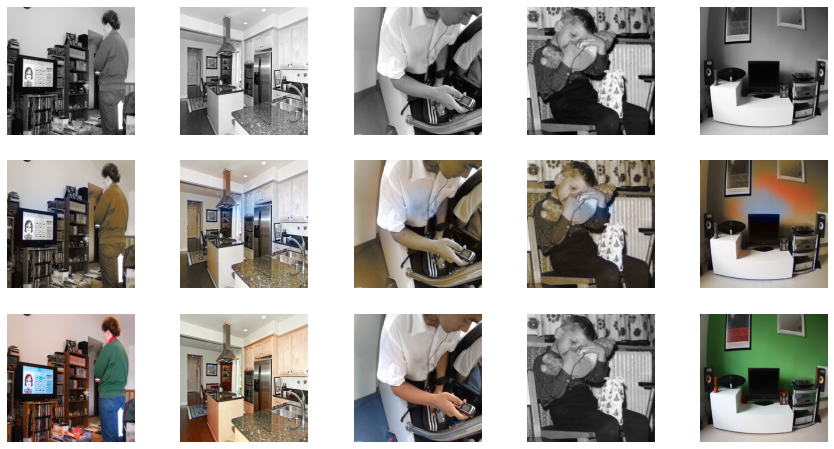


Epoch 1/20
Iteration 400/500
loss_D_fake: 0.47550
loss_D_real: 0.50028
loss_D: 0.48789
loss_G_GAN: 1.58106
loss_G_L1: 9.81724
loss_G: 11.39830


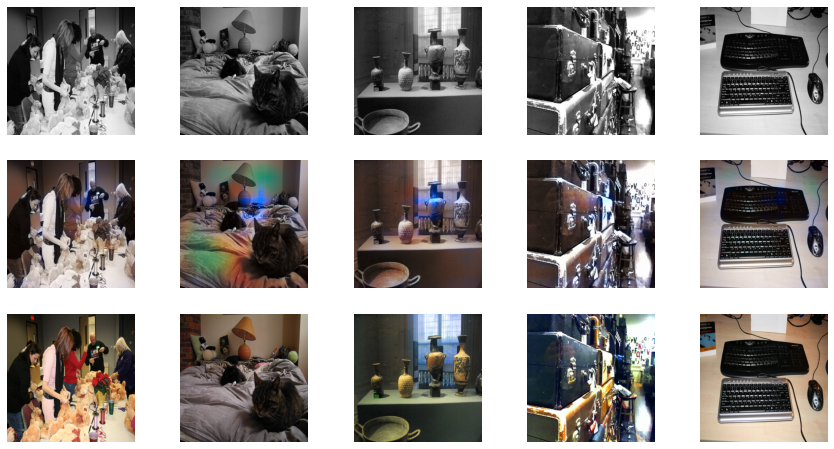

  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 2/20
Iteration 200/500
loss_D_fake: 0.50209
loss_D_real: 0.52654
loss_D: 0.51431
loss_G_GAN: 1.45076
loss_G_L1: 10.82279
loss_G: 12.27356


/opt/conda/lib/python3.7/site-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 1 pixels
  return func(*args, **kwargs)
/opt/conda/lib/python3.7/site-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 8 pixels
  return func(*args, **kwargs)


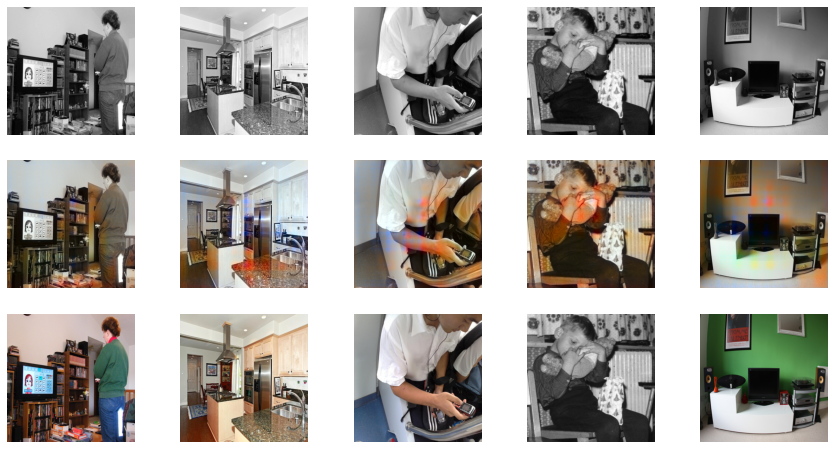


Epoch 2/20
Iteration 400/500
loss_D_fake: 0.49674
loss_D_real: 0.53222
loss_D: 0.51448
loss_G_GAN: 1.40970
loss_G_L1: 10.82064
loss_G: 12.23034


/opt/conda/lib/python3.7/site-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 19 pixels
  return func(*args, **kwargs)
/opt/conda/lib/python3.7/site-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 22 pixels
  return func(*args, **kwargs)
/opt/conda/lib/python3.7/site-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 12 pixels
  return func(*args, **kwargs)
/opt/conda/lib/python3.7/site-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 31 pixels
  return func(*args, **kwargs)
/opt/conda/lib/python3.7/site-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 59 pixels
  return func(*args, **kwargs)


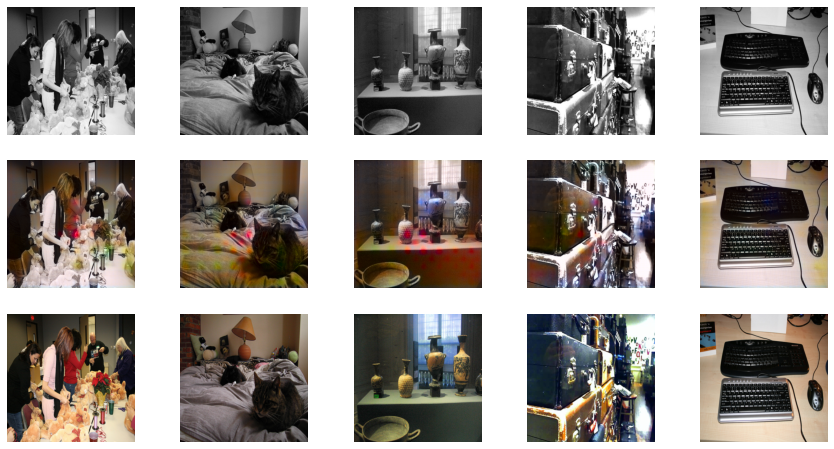

  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 3/20
Iteration 200/500
loss_D_fake: 0.50339
loss_D_real: 0.55216
loss_D: 0.52778
loss_G_GAN: 1.33770
loss_G_L1: 10.94969
loss_G: 12.28739


/opt/conda/lib/python3.7/site-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 80 pixels
  return func(*args, **kwargs)
/opt/conda/lib/python3.7/site-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 9 pixels
  return func(*args, **kwargs)
/opt/conda/lib/python3.7/site-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 136 pixels
  return func(*args, **kwargs)


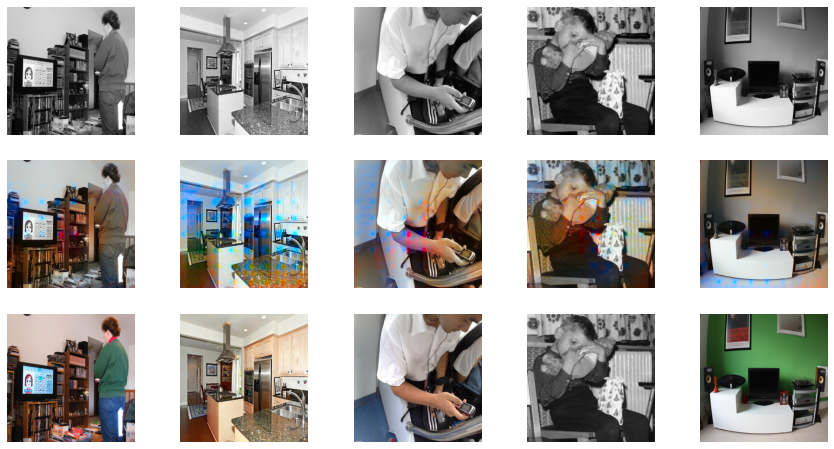


Epoch 3/20
Iteration 400/500
loss_D_fake: 0.50503
loss_D_real: 0.56021
loss_D: 0.53262
loss_G_GAN: 1.33963
loss_G_L1: 10.91815
loss_G: 12.25778


/opt/conda/lib/python3.7/site-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 5 pixels
  return func(*args, **kwargs)
/opt/conda/lib/python3.7/site-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 11 pixels
  return func(*args, **kwargs)
/opt/conda/lib/python3.7/site-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 2 pixels
  return func(*args, **kwargs)


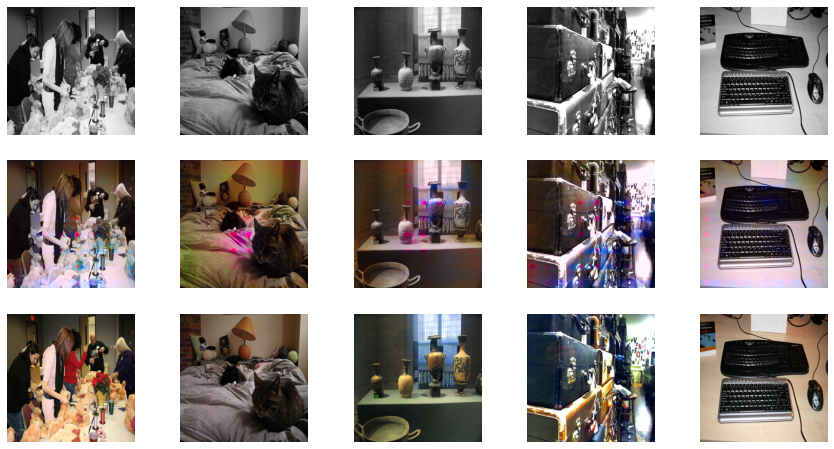

  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 4/20
Iteration 200/500
loss_D_fake: 0.51868
loss_D_real: 0.57362
loss_D: 0.54615
loss_G_GAN: 1.27459
loss_G_L1: 10.92141
loss_G: 12.19599


/opt/conda/lib/python3.7/site-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 92 pixels
  return func(*args, **kwargs)
/opt/conda/lib/python3.7/site-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 30 pixels
  return func(*args, **kwargs)
/opt/conda/lib/python3.7/site-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 56 pixels
  return func(*args, **kwargs)
/opt/conda/lib/python3.7/site-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 15 pixels
  return func(*args, **kwargs)


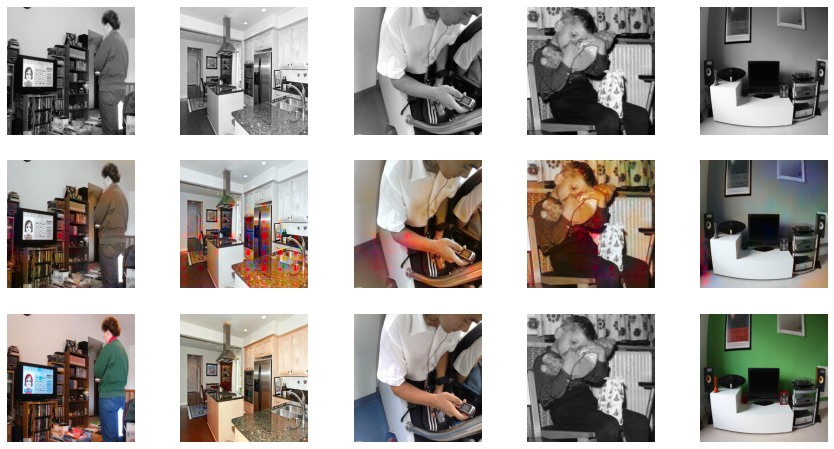


Epoch 4/20
Iteration 400/500
loss_D_fake: 0.52129
loss_D_real: 0.57469
loss_D: 0.54799
loss_G_GAN: 1.26807
loss_G_L1: 10.88135
loss_G: 12.14942


/opt/conda/lib/python3.7/site-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 10 pixels
  return func(*args, **kwargs)
/opt/conda/lib/python3.7/site-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 4 pixels
  return func(*args, **kwargs)


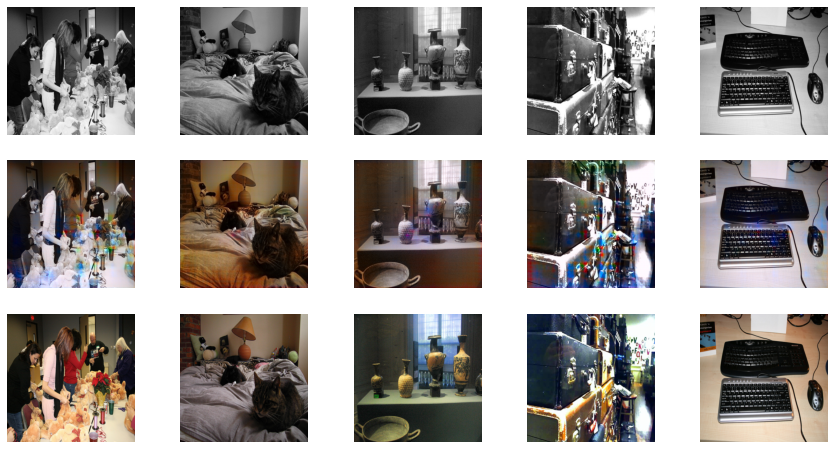

  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 5/20
Iteration 200/500
loss_D_fake: 0.52546
loss_D_real: 0.58079
loss_D: 0.55312
loss_G_GAN: 1.22853
loss_G_L1: 10.86466
loss_G: 12.09319


/opt/conda/lib/python3.7/site-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 17 pixels
  return func(*args, **kwargs)
/opt/conda/lib/python3.7/site-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 6 pixels
  return func(*args, **kwargs)


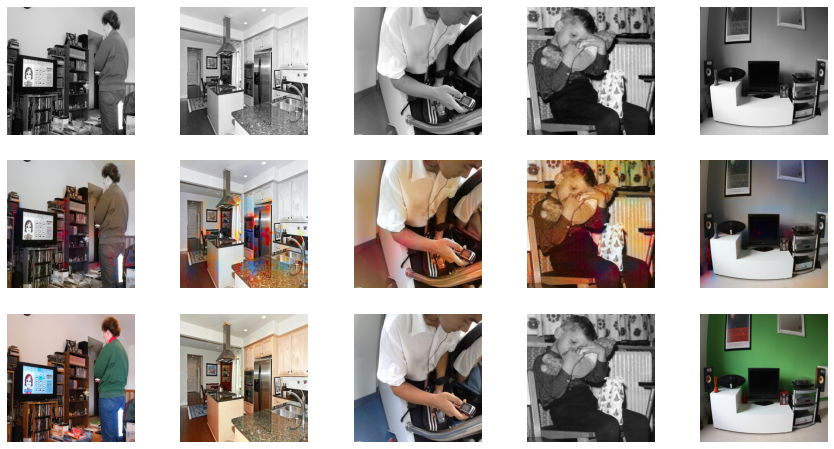


Epoch 5/20
Iteration 400/500
loss_D_fake: 0.52573
loss_D_real: 0.58057
loss_D: 0.55315
loss_G_GAN: 1.23987
loss_G_L1: 10.83082
loss_G: 12.07069


/opt/conda/lib/python3.7/site-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 61 pixels
  return func(*args, **kwargs)
/opt/conda/lib/python3.7/site-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 3 pixels
  return func(*args, **kwargs)
/opt/conda/lib/python3.7/site-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 47 pixels
  return func(*args, **kwargs)


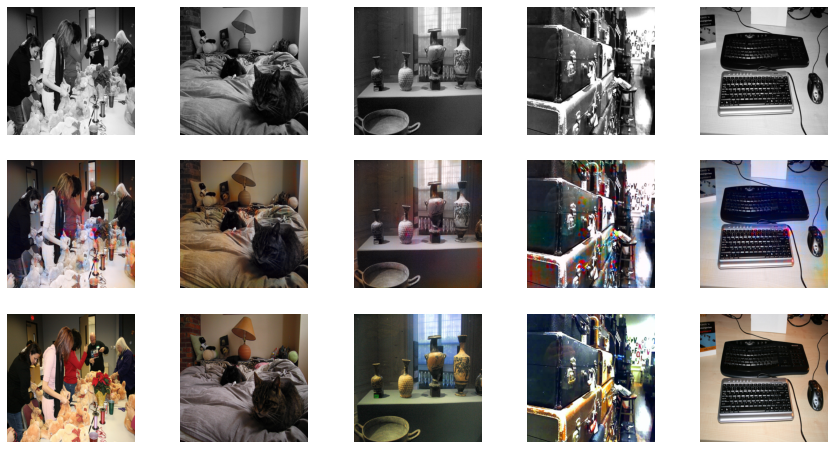

  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 6/20
Iteration 200/500
loss_D_fake: 0.52596
loss_D_real: 0.58570
loss_D: 0.55583
loss_G_GAN: 1.21326
loss_G_L1: 10.78649
loss_G: 11.99975


/opt/conda/lib/python3.7/site-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 62 pixels
  return func(*args, **kwargs)
/opt/conda/lib/python3.7/site-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 99 pixels
  return func(*args, **kwargs)
/opt/conda/lib/python3.7/site-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 24 pixels
  return func(*args, **kwargs)


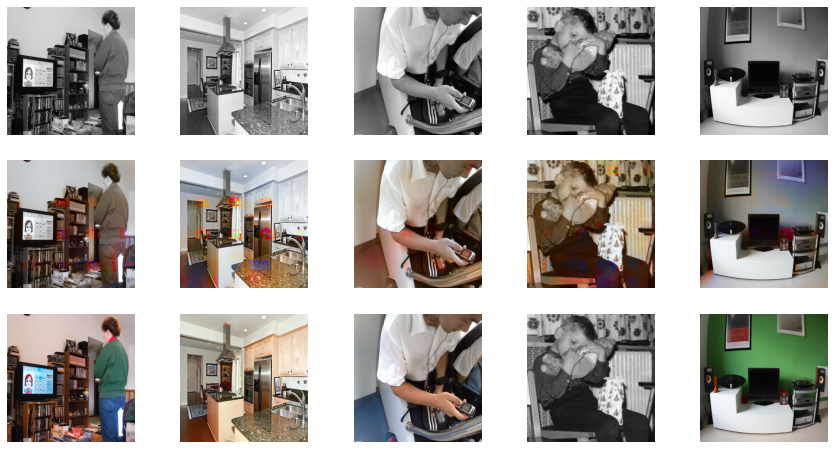


Epoch 6/20
Iteration 400/500
loss_D_fake: 0.52399
loss_D_real: 0.57869
loss_D: 0.55134
loss_G_GAN: 1.24028
loss_G_L1: 10.78737
loss_G: 12.02765


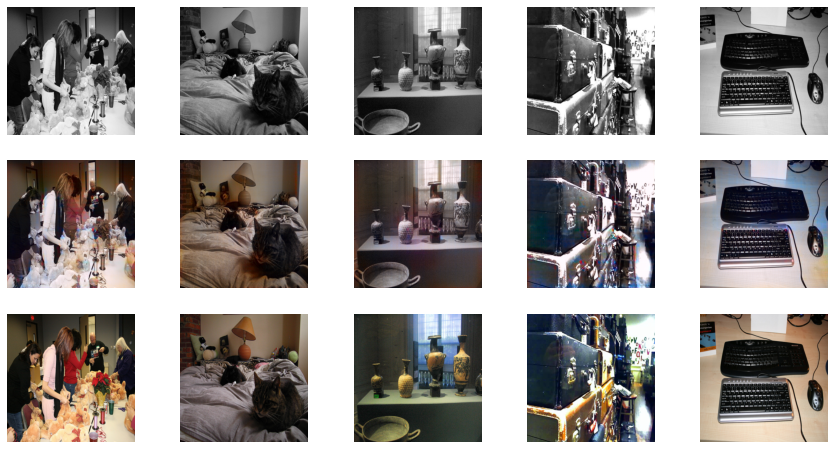

  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 7/20
Iteration 200/500
loss_D_fake: 0.52556
loss_D_real: 0.58560
loss_D: 0.55558
loss_G_GAN: 1.22683
loss_G_L1: 10.65893
loss_G: 11.88575


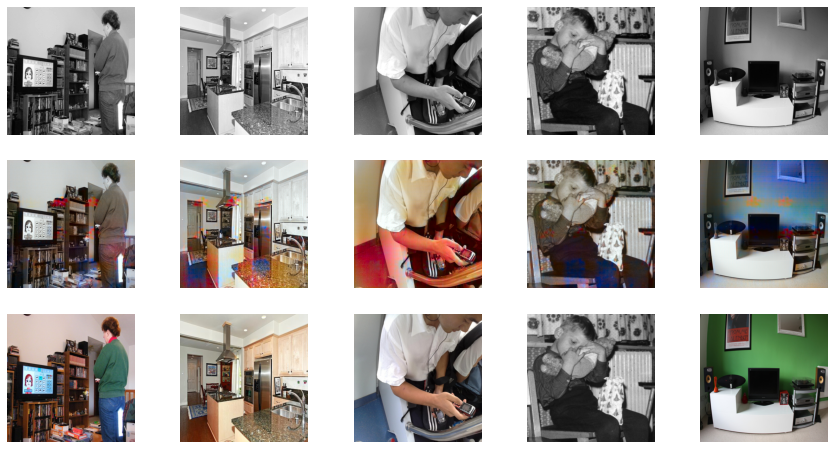


Epoch 7/20
Iteration 400/500
loss_D_fake: 0.52329
loss_D_real: 0.57494
loss_D: 0.54912
loss_G_GAN: 1.24628
loss_G_L1: 10.67014
loss_G: 11.91642


/opt/conda/lib/python3.7/site-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 70 pixels
  return func(*args, **kwargs)
/opt/conda/lib/python3.7/site-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 40 pixels
  return func(*args, **kwargs)


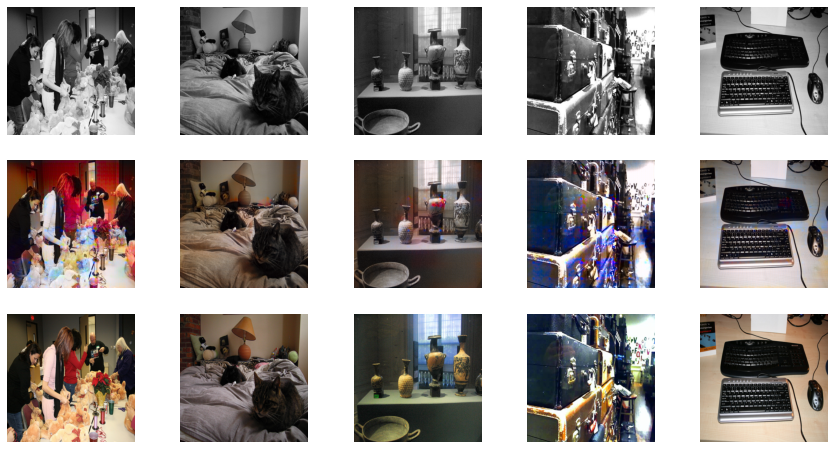

  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 8/20
Iteration 200/500
loss_D_fake: 0.52858
loss_D_real: 0.58278
loss_D: 0.55568
loss_G_GAN: 1.21783
loss_G_L1: 10.52988
loss_G: 11.74772


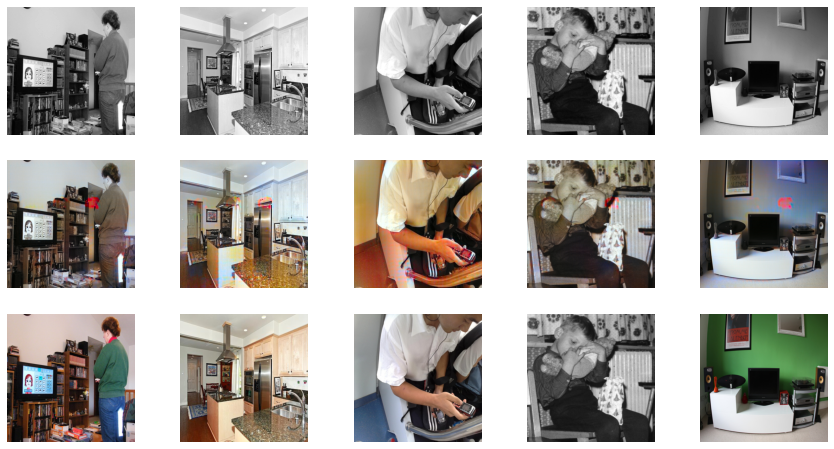


Epoch 8/20
Iteration 400/500
loss_D_fake: 0.52899
loss_D_real: 0.58130
loss_D: 0.55515
loss_G_GAN: 1.23551
loss_G_L1: 10.52727
loss_G: 11.76279


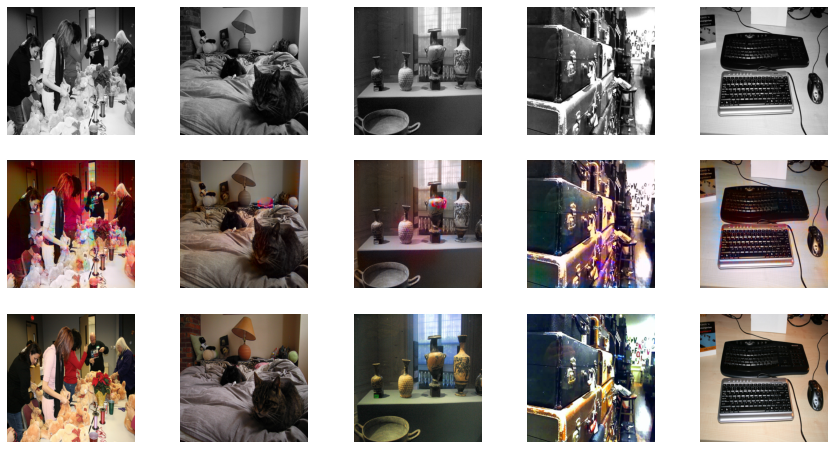

  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 9/20
Iteration 200/500
loss_D_fake: 0.54660
loss_D_real: 0.59876
loss_D: 0.57268
loss_G_GAN: 1.19898
loss_G_L1: 10.35013
loss_G: 11.54912


/opt/conda/lib/python3.7/site-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 37 pixels
  return func(*args, **kwargs)


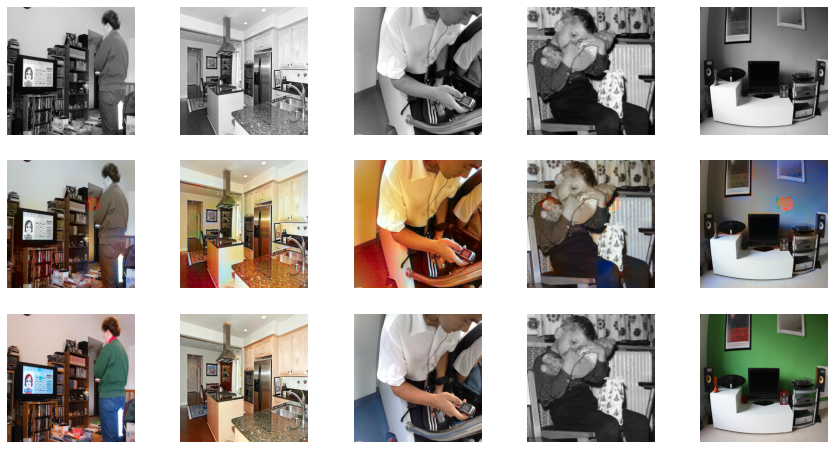


Epoch 9/20
Iteration 400/500
loss_D_fake: 0.53357
loss_D_real: 0.58609
loss_D: 0.55983
loss_G_GAN: 1.20435
loss_G_L1: 10.33608
loss_G: 11.54043


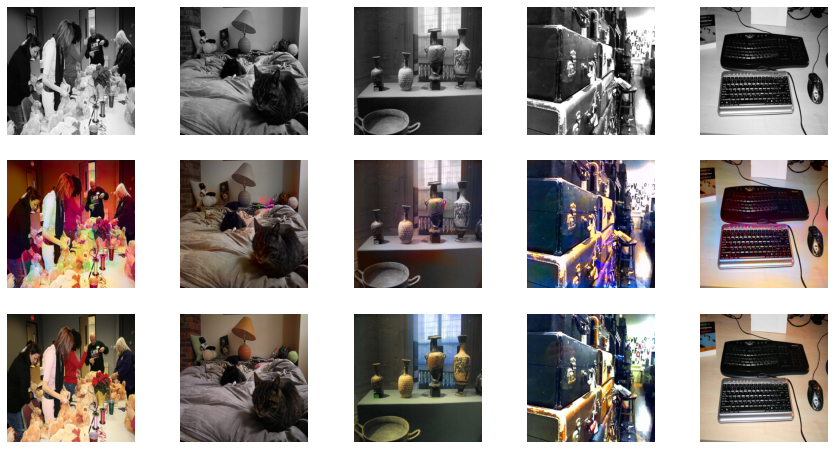

  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 10/20
Iteration 200/500
loss_D_fake: 0.54068
loss_D_real: 0.59530
loss_D: 0.56799
loss_G_GAN: 1.18767
loss_G_L1: 10.11681
loss_G: 11.30448


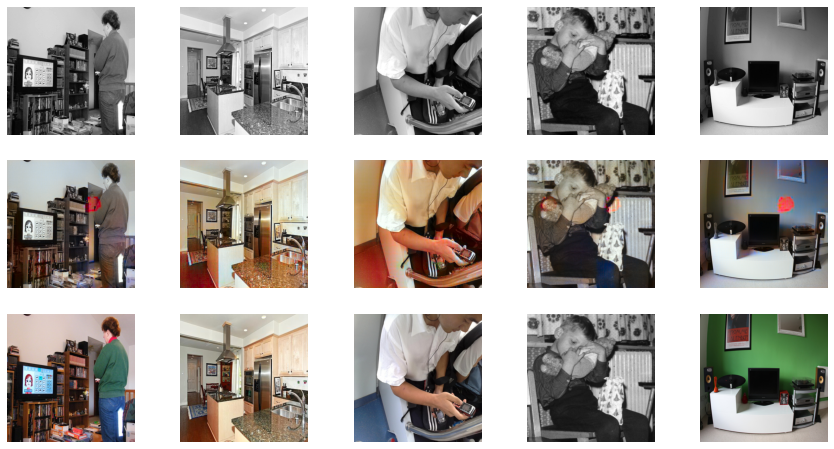


Epoch 10/20
Iteration 400/500
loss_D_fake: 0.53458
loss_D_real: 0.58754
loss_D: 0.56106
loss_G_GAN: 1.20263
loss_G_L1: 10.09297
loss_G: 11.29560


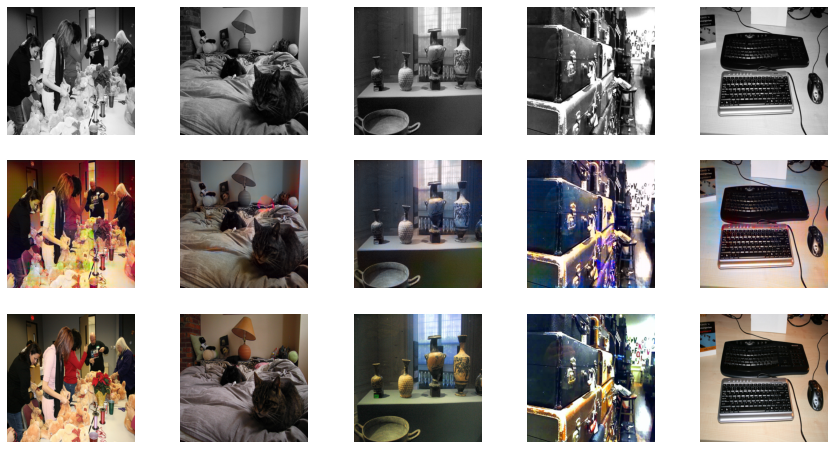

  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 11/20
Iteration 200/500
loss_D_fake: 0.53572
loss_D_real: 0.58923
loss_D: 0.56248
loss_G_GAN: 1.20121
loss_G_L1: 9.83296
loss_G: 11.03417


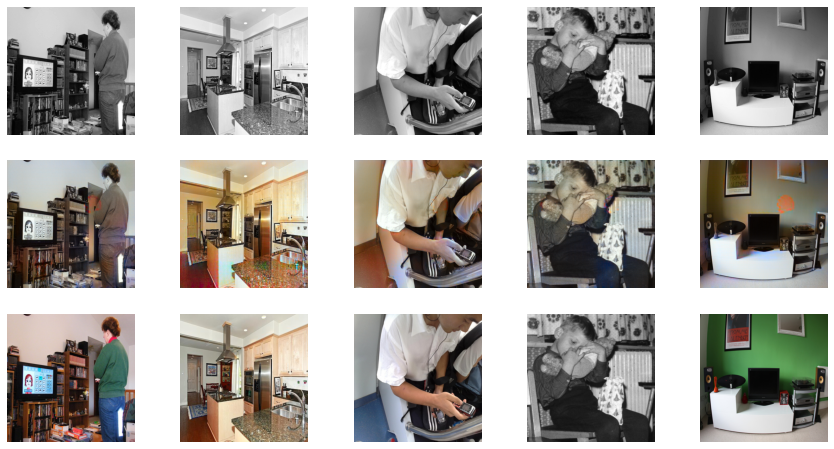


Epoch 11/20
Iteration 400/500
loss_D_fake: 0.52939
loss_D_real: 0.58104
loss_D: 0.55521
loss_G_GAN: 1.21669
loss_G_L1: 9.83283
loss_G: 11.04952


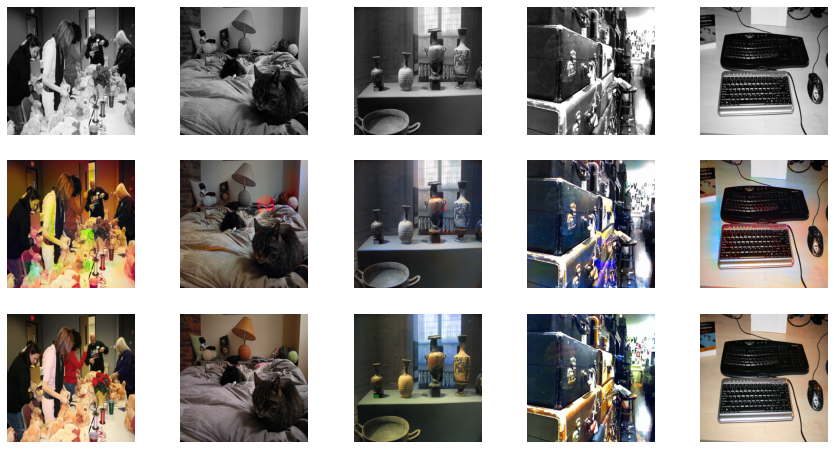

  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 12/20
Iteration 200/500
loss_D_fake: 0.53066
loss_D_real: 0.57276
loss_D: 0.55171
loss_G_GAN: 1.22681
loss_G_L1: 9.61770
loss_G: 10.84451


/opt/conda/lib/python3.7/site-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 7 pixels
  return func(*args, **kwargs)


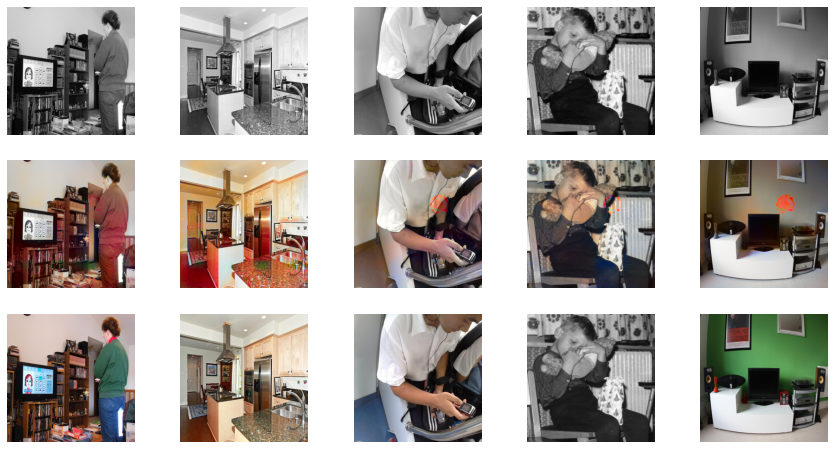


Epoch 12/20
Iteration 400/500
loss_D_fake: 0.52660
loss_D_real: 0.57138
loss_D: 0.54899
loss_G_GAN: 1.22551
loss_G_L1: 9.59119
loss_G: 10.81670


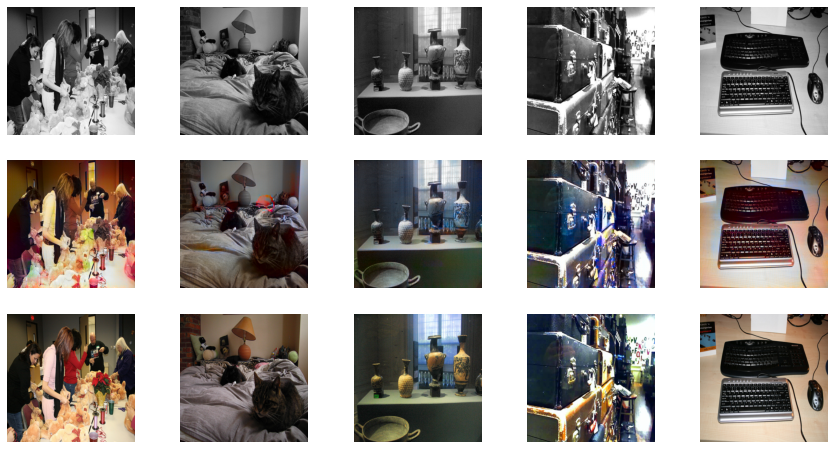

  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 13/20
Iteration 200/500
loss_D_fake: 0.52078
loss_D_real: 0.56625
loss_D: 0.54352
loss_G_GAN: 1.22534
loss_G_L1: 9.36358
loss_G: 10.58893


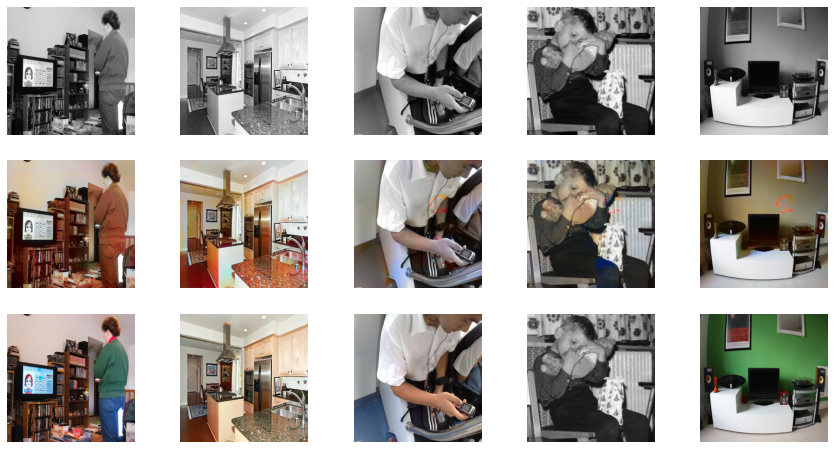


Epoch 13/20
Iteration 400/500
loss_D_fake: 0.52225
loss_D_real: 0.56663
loss_D: 0.54444
loss_G_GAN: 1.22094
loss_G_L1: 9.33482
loss_G: 10.55576


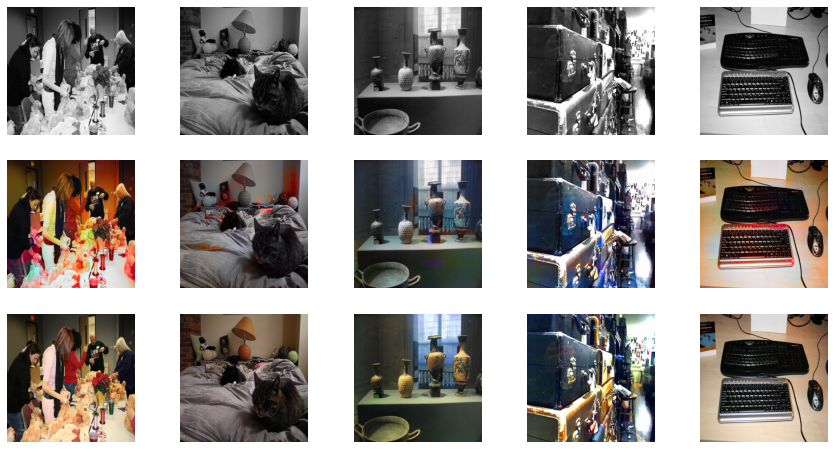

  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 14/20
Iteration 200/500
loss_D_fake: 0.52737
loss_D_real: 0.56724
loss_D: 0.54731
loss_G_GAN: 1.23061
loss_G_L1: 9.15017
loss_G: 10.38078


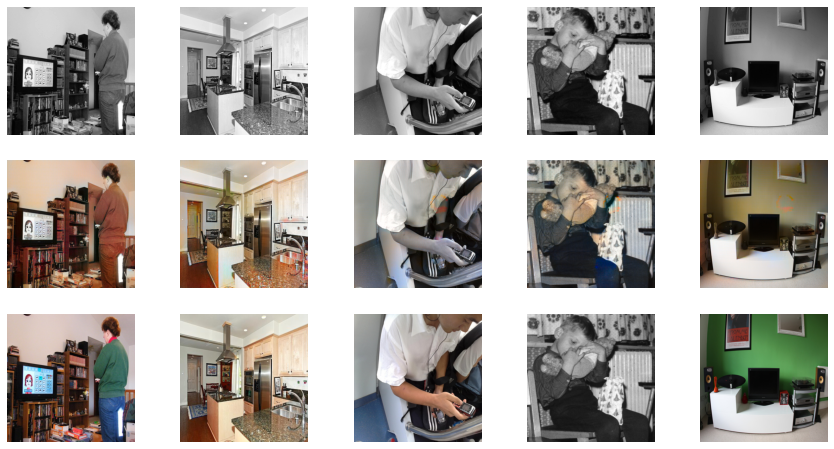


Epoch 14/20
Iteration 400/500
loss_D_fake: 0.52609
loss_D_real: 0.56587
loss_D: 0.54598
loss_G_GAN: 1.22509
loss_G_L1: 9.11336
loss_G: 10.33845


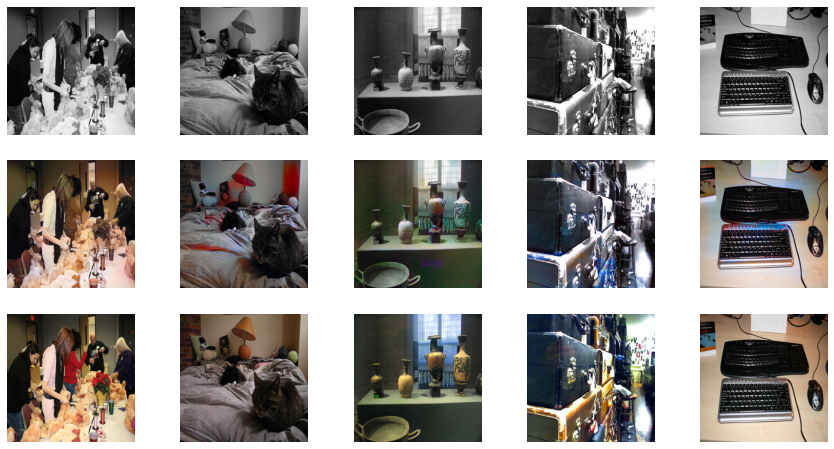

  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 15/20
Iteration 200/500
loss_D_fake: 0.52153
loss_D_real: 0.55860
loss_D: 0.54007
loss_G_GAN: 1.22819
loss_G_L1: 8.91798
loss_G: 10.14618


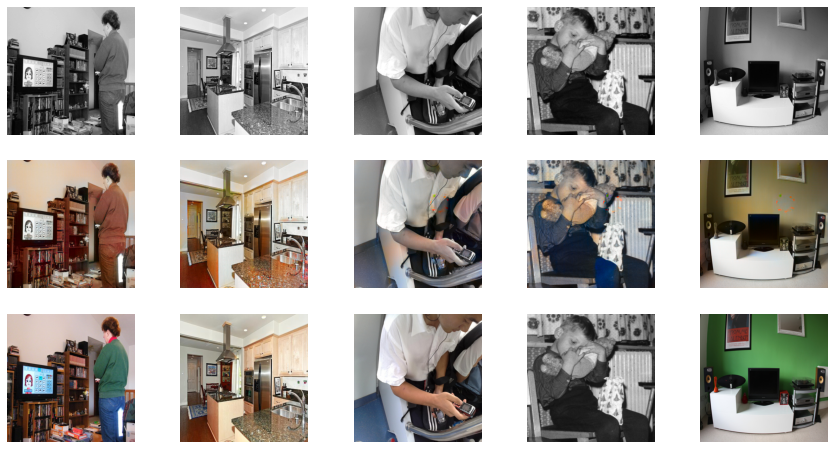


Epoch 15/20
Iteration 400/500
loss_D_fake: 0.52471
loss_D_real: 0.55952
loss_D: 0.54212
loss_G_GAN: 1.23102
loss_G_L1: 8.87585
loss_G: 10.10687


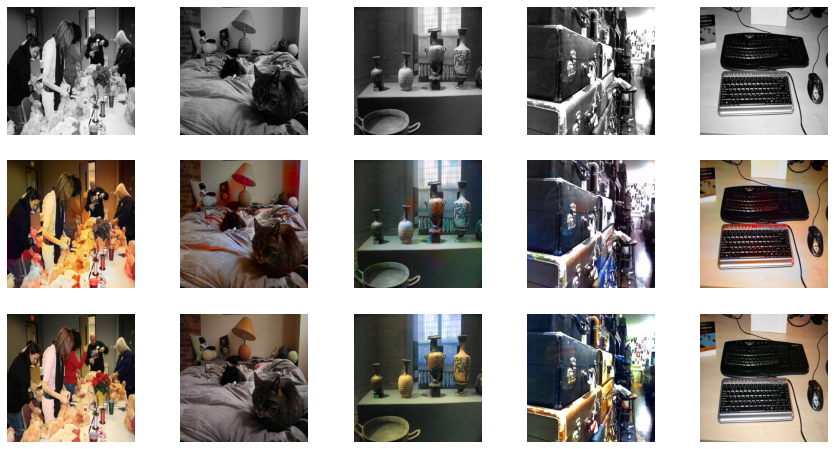

  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 16/20
Iteration 200/500
loss_D_fake: 0.52506
loss_D_real: 0.55243
loss_D: 0.53875
loss_G_GAN: 1.25445
loss_G_L1: 8.71251
loss_G: 9.96696


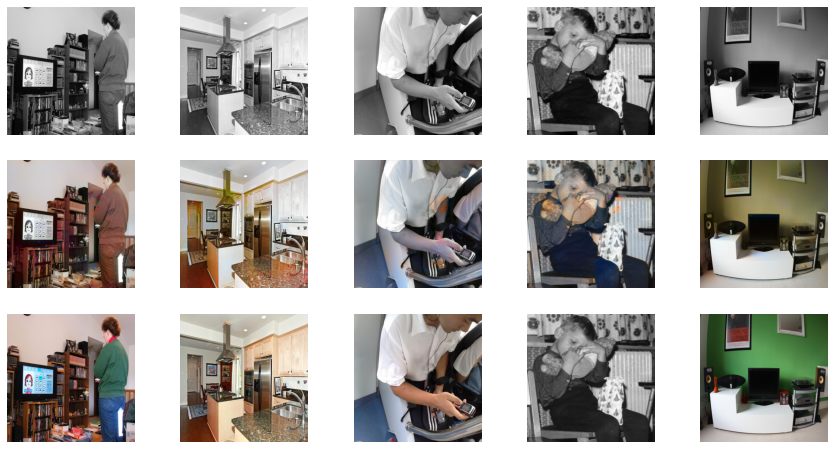


Epoch 16/20
Iteration 400/500
loss_D_fake: 0.52338
loss_D_real: 0.55359
loss_D: 0.53848
loss_G_GAN: 1.24587
loss_G_L1: 8.66033
loss_G: 9.90620


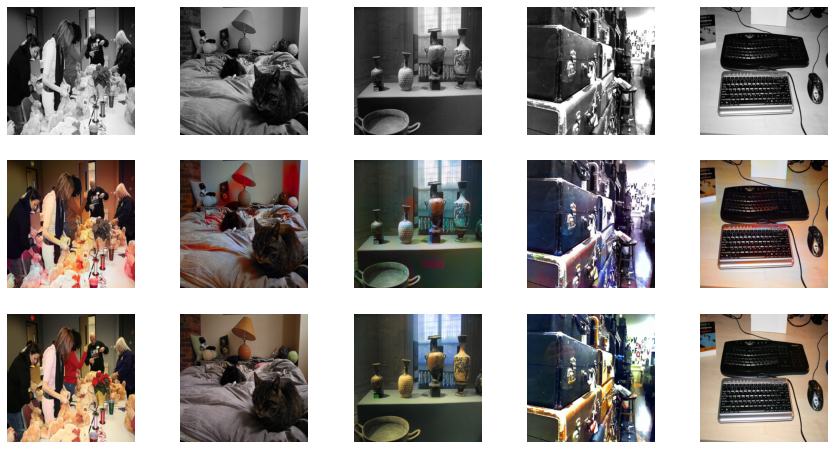

  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 17/20
Iteration 200/500
loss_D_fake: 0.52293
loss_D_real: 0.55447
loss_D: 0.53870
loss_G_GAN: 1.24769
loss_G_L1: 8.54111
loss_G: 9.78881


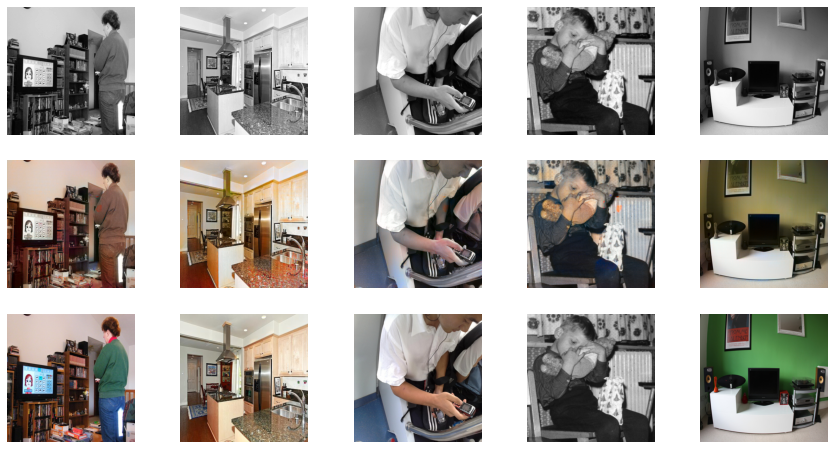


Epoch 17/20
Iteration 400/500
loss_D_fake: 0.52292
loss_D_real: 0.55395
loss_D: 0.53843
loss_G_GAN: 1.24709
loss_G_L1: 8.48830
loss_G: 9.73539


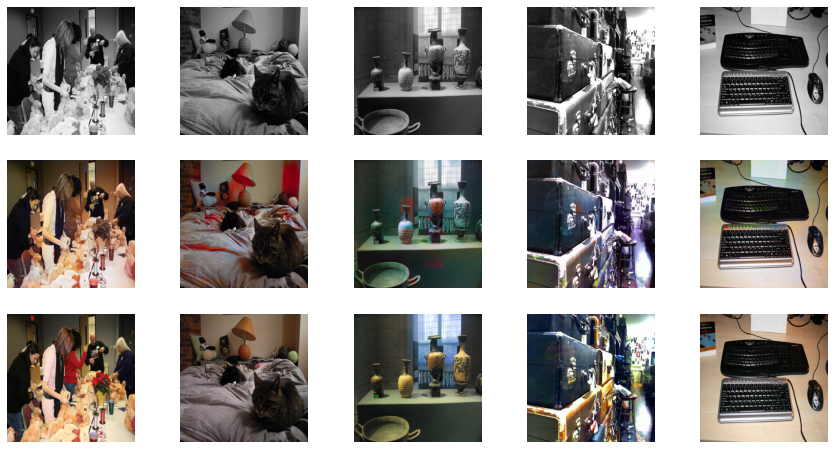

  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 18/20
Iteration 200/500
loss_D_fake: 0.52962
loss_D_real: 0.55293
loss_D: 0.54127
loss_G_GAN: 1.27204
loss_G_L1: 8.34542
loss_G: 9.61746


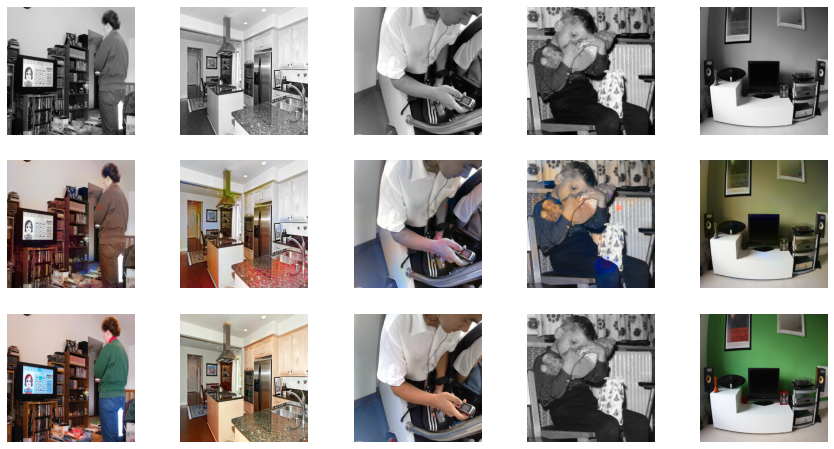


Epoch 18/20
Iteration 400/500
loss_D_fake: 0.52414
loss_D_real: 0.55007
loss_D: 0.53711
loss_G_GAN: 1.26056
loss_G_L1: 8.28646
loss_G: 9.54703


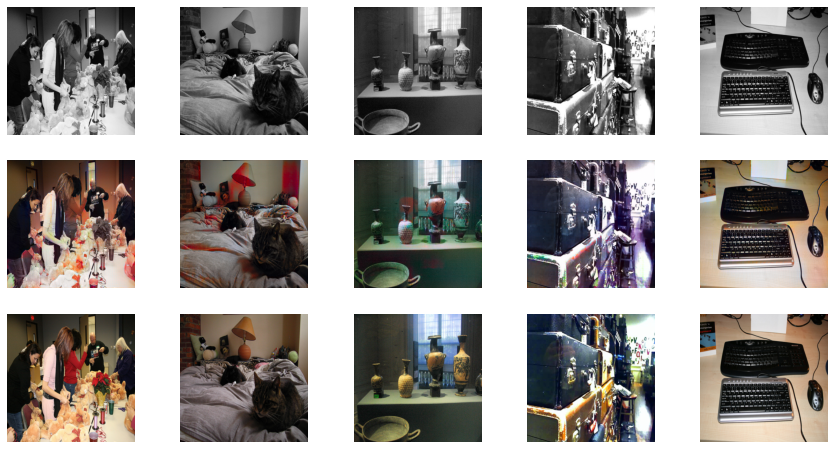

  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 19/20
Iteration 200/500
loss_D_fake: 0.52557
loss_D_real: 0.54987
loss_D: 0.53772
loss_G_GAN: 1.27471
loss_G_L1: 8.18002
loss_G: 9.45474


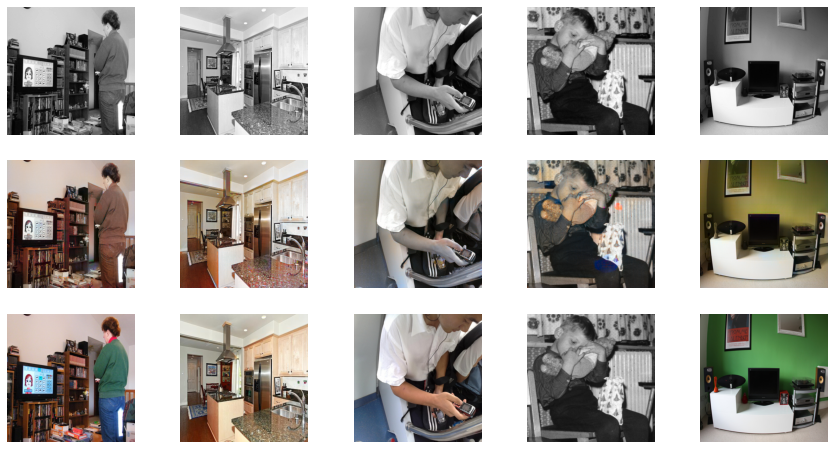


Epoch 19/20
Iteration 400/500
loss_D_fake: 0.52383
loss_D_real: 0.54927
loss_D: 0.53655
loss_G_GAN: 1.27037
loss_G_L1: 8.13007
loss_G: 9.40045


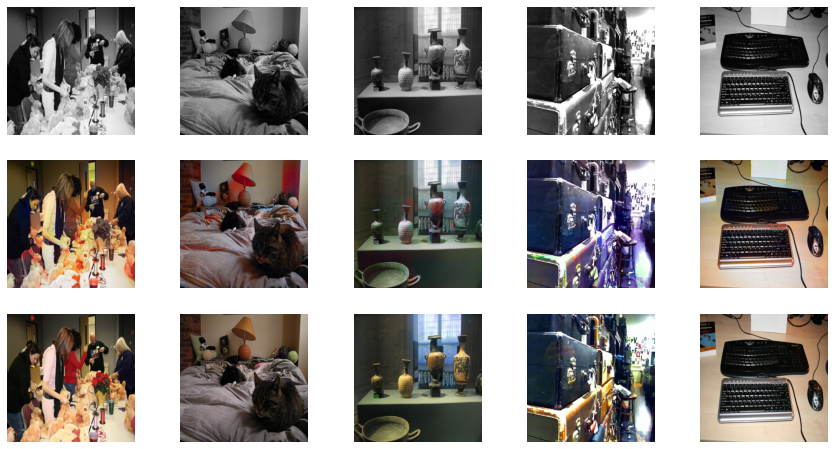

  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 20/20
Iteration 200/500
loss_D_fake: 0.52305
loss_D_real: 0.54046
loss_D: 0.53175
loss_G_GAN: 1.27989
loss_G_L1: 7.99836
loss_G: 9.27825


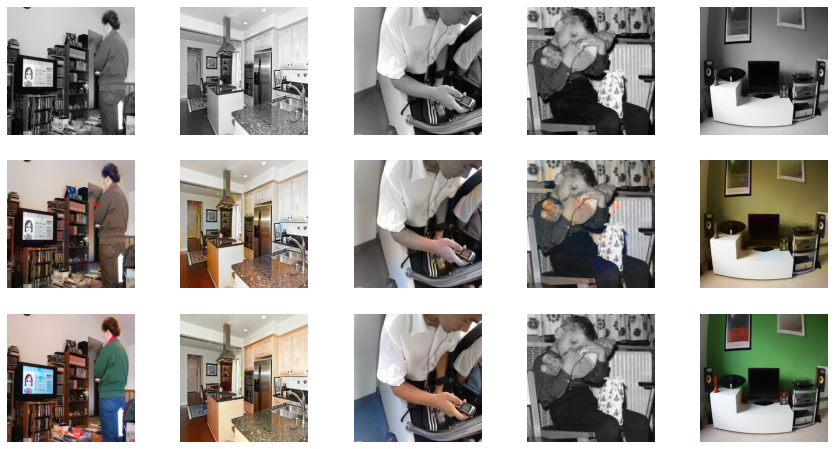


Epoch 20/20
Iteration 400/500
loss_D_fake: 0.52203
loss_D_real: 0.54296
loss_D: 0.53250
loss_G_GAN: 1.27346
loss_G_L1: 7.95131
loss_G: 9.22477


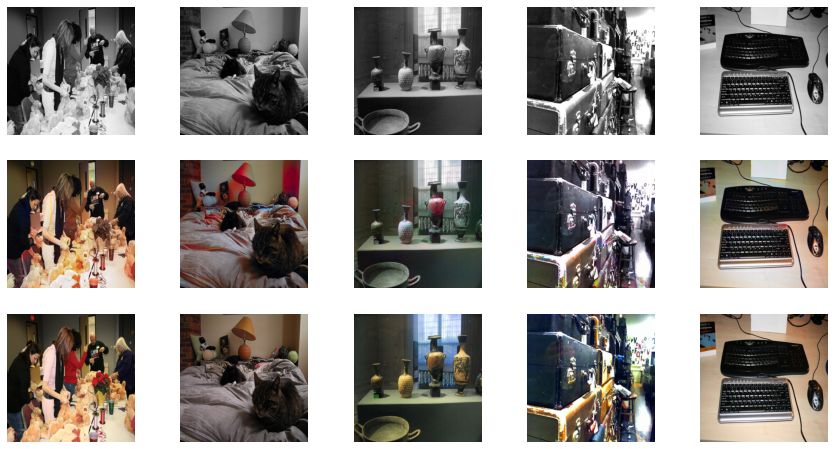

In [16]:
def train_model(model, train_dl, epochs, display_every=200):
    data = next(iter(val_dl)) # getting a batch for visualizing the model output after fixed intrvals
    for e in range(epochs):
        loss_meter_dict = create_loss_meters() # function returing a dictionary of objects to 
        i = 0                                  # log the losses of the complete network
        for data in tqdm(train_dl):
            model.setup_input(data) 
            model.optimize()
            update_losses(model, loss_meter_dict, count=data['L'].size(0)) # function updating the log objects
            i += 1
            if i % display_every == 0:
                print(f"\nEpoch {e+1}/{epochs}")
                print(f"Iteration {i}/{len(train_dl)}")
                log_results(loss_meter_dict) # function to print out the losses
                visualize(model, data, save=False) # function displaying the model's outputs

model = MainModel()
train_model(model, train_dl, 20)